# Finetuning dreambooth with Azure ML
## Add your own Objects and Styles to Image Generation Models

This solution enables you to **inject any object into an existing image generation model like Stable Diffusion using a few example images**. It can also be used for teaching artistic styles (e.g., company branding photography).


**Azure Machine Learning facilitates advanced Generative AI use cases** with its robust resources and efficient experiment management capabilities.

**Powerful GPU clusters** enable multiple resource-intensive fine-tuning runs concurrently.
Azure ML provides a framework to manage all associated artifacts, including image datasets, environments, and the resulting models, in a systematic and repeatable manner.
The platform's experiment management feature allows maintaining control over numerous training runs, while effectively tracking hyperparameters and results

**This notebook provides a practical framework for fine-tuning existing image generation models, such as Stable Diffusion, using [DreamBooth](https://huggingface.co/docs/diffusers/training/dreambooth) and Azure Machine Learning.** 

The primary goal is to enable the model to generate images of specific subjects or concepts, based on a set of sample images. This process can be used to insert a specific object into entirely new contexts or scenes.

Potential business applications facilitated by this framework include content creation, product visualization, advertising and marketing, as well as education and training. The fine-tuning operation will be executed using Azure Machine Learning, leveraging its scalability for training on powerful GPU compute resources and its capabilities for managing and tracking experiments and image datasets.

In this solution framework, you will:

1. Connect to your Azure Machine Learning Workspace and establish the required resources.
2. Provide training images of the specific subject to be incorporated into the image generation model.
3. Configure and initiate the fine-tuning training job.
4. Review the experiment results and retrieve key artifacts, including model checkpoints.
5. Generate new images of your chosen subject in diverse scenes.

This notebook is designed as a solution template for leveraging Azure ML and DreamBooth for fine-tuning image generation models within business contexts, providing a solution framework that can be adapted to specific needs and applications.

### Development resources:
- Dreambooth scripts: https://github.com/huggingface/diffusers/tree/main/examples

### Source: https://github.com/Azure/gen-cv


## 1. Setup

In [1]:
# %pip install --upgrade -r requirements.txt

In [2]:
import math
import matplotlib.pyplot as plt
import mlflow
import os
import random
import requests
import shutil
import subprocess
import sys
import shutil
import torch

from azure.ai.ml import automl, Input, Output, MLClient, command, load_job
from azure.ai.ml.constants import AssetTypes
from azure.ai.ml.entities import Data, Environment, AmlCompute
from azure.core.exceptions import ResourceNotFoundError
from azure.identity import DefaultAzureCredential, InteractiveBrowserCredential

from datetime import datetime
from diffusers import StableDiffusionPipeline, DDIMScheduler
from io import BytesIO
from mlflow.tracking.client import MlflowClient
from PIL import Image

### Session info

In [3]:
sys.version

'3.10.10 (main, Mar 21 2023, 18:45:11) [GCC 11.2.0]'

In [4]:
def get_gpu_info():
    """
    Get GPU info
    """
    try:
        output = subprocess.check_output(['nvidia-smi'])
        output = output.decode('utf-8')
        return output

    except subprocess.CalledProcessError as e:
        print("Error executing nvidia-smi command:", e.output)
        return None

In [5]:
print(get_gpu_info())

Tue Jun 13 11:06:22 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.182.03   Driver Version: 470.182.03   CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000001:00:00.0 Off |                  Off |
| N/A   32C    P0    24W / 250W |      4MiB / 16160MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Settings

In [6]:
subscription_id = "to_be_replaced"  # Azure Subscription id
resource_group = "to_be_replaced"  # Azure ML resource group
workspace_name = "to_be_replaced"  # Azure ML workspace

In [7]:
azure_cv_endpoint = "to_be_replaced"
azure_cv_key = "to_be_replaced"

In [8]:
local_train_data = "./train-data/toy/"  # Your local images for training the model

In [9]:
generated_images = "./results/toy"  # Results images

if os.path.exists(generated_images):
    shutil.rmtree(generated_images)

os.makedirs(generated_images, exist_ok=True)

In [10]:
azureml_dataset_name = "toyimages"  # Name of the Azure ML dataset to create later
train_target = "gpu-cluster"  # Name of the Azure ML gpu cluster to create later
experiment_name = "dreambooth-finetuning"  # Name of the Azure ML job name

### Function

In [207]:
def view_images(images_list, cols=3, disp_filename=True, disp_axis=False):
    """
    Display images from a python list.
    """
    print("Number of images =", len(images_list))
    
    rows = int(math.ceil(len(images_list) / cols))
    fig = plt.figure(figsize=(cols * 5, rows * 5))

    for idx, image in enumerate(images_list):
        plt.subplot(rows, cols, idx + 1)
        img = Image.open(image)
        
        if disp_filename:
            title = "Image " + str(idx+1) + "\n" + image
            plt.title(title)
               
        plt.imshow(img)
        plt.axis("off")
        
        if disp_axis:
            plt.axis("on")

    fig.tight_layout()
    plt.show()

In [12]:
def remove_background(image_file, new_dir):
    """
    Removing background with Azure Computer Vision 4
    """
    url = azure_cv_endpoint + "/computervision/imageanalysis:segment?api-version=2023-02-01-preview"
    background_removal = "&mode=backgroundRemoval"
    remove_background_url = url + background_removal  # For removing the background

    headers = {"Content-type": "application/octet-stream", 
               "Ocp-Apim-Subscription-Key": azure_cv_key}

    (file, ext) = os.path.splitext(os.path.basename(image_file))
    without_background_file = os.path.join(new_dir, "without_background_" + file + ext)

    with open(image_file, "rb") as f:
        data = f.read()

    # Remove background
    r = requests.post(remove_background_url, data=data, headers=headers)

    with open(without_background_file, "wb") as f:
        f.write(r.content)

    return without_background_file


## 2. Connect to Azure Machine Learning Workspace

In [13]:
try:
    credential = DefaultAzureCredential()
    # Check if given credential can get token successfully.
    credential.get_token("https://management.azure.com/.default")

except Exception as ex:
    # Fall back to InteractiveBrowserCredential in case DefaultAzureCredential not work
    credential = InteractiveBrowserCredential()

# Get handle to Workspace
try:
    ml_client = MLClient.from_config(credential=credential)

except Exception as ex:
    ml_client = MLClient(
        subscription_id=subscription_id,
        resource_group_name=resource_group,
        workspace_name=workspace_name,
        credential=credential,
    )

print("Test Workspace access by listing compute resources ... ")
print([compute.name for compute in ml_client.compute.list()])

Found the config file in: /config.json


Test Workspace access by listing compute resources ... 
['standardd32dv4', 'GPUinstancenc6']


## 3. Establish required Azure ML Resources

The subsequent steps will lead to the creation of the following resources:

1. A GPU cluster for the fine-tuning job.
2. An Azure ML Dataset registration for the training images.
3. A Python environment registration for executing the fine-tuning job.  

__Note__: These steps only need to be performed once. If you've already executed this cell, you may proceed directly to the [Show Training Samples](#Show-Training-Samples) section. If updates to these resources are necessary, feel free to re-run these cells.

In this demonstration, we utilize low-priority compute for cost efficiency. While low-priority VMs offer significant cost savings compared to standard dedicated compute, availability may fluctuate, and there is a risk of training jobs being pre-empted.


### Creating or using the compute clusters

In [14]:
try:
    _ = ml_client.compute.get(train_target)
    print("Found existing compute target.")

except ResourceNotFoundError:
    print("Creating a new compute target...")

    compute_config = AmlCompute(
        name=train_target,
        type="amlcompute",
        size="Standard_NC96ads_A100_v4",
        tier="low_priority",
        idle_time_before_scale_down=600,
        min_instances=0,
        max_instances=2,
    )
    ml_client.begin_create_or_update(compute_config)

Creating a new compute target...


### Creating the Azure ML environment

In [15]:
environment = Environment(
    image="mcr.microsoft.com/azureml/aifx/stable-ubuntu2004-cu115-py38-torch1110:biweekly.202302.1",
    conda_file="./dreambooth-conda.yaml",
    name="dreambooth-env",
    description="Dreambooth training environment",
)

environment

Environment({'is_anonymous': False, 'auto_increment_version': True, 'name': 'dreambooth-env', 'description': 'Dreambooth training environment', 'tags': {}, 'properties': {}, 'print_as_yaml': True, 'id': None, 'Resource__source_path': None, 'base_path': '/mnt/batch/tasks/shared/LS_root/mounts/clusters/gpuinstancenc6/code/Users/seretkow/Dreambooth with Azure ML', 'creation_context': None, 'serialize': <msrest.serialization.Serializer object at 0x7f63eada6f80>, 'version': None, 'latest_version': None, 'conda_file': {'channels': ['conda-forge'], 'dependencies': ['python=3.8', 'numpy=1.21.2', 'pip=21.2.4', 'pandas>=1.1,<1.2', {'pip': ['mlflow== 1.26.1', 'azureml-mlflow==1.42.0', 'psutil>=5.8,<5.9', 'tqdm>=4.59,<4.60', 'ipykernel~=6.0', 'matplotlib', 'git+https://github.com/huggingface/diffusers.git', 'accelerate>=0.16.0', 'transformers>=4.25.1', 'ftfy', 'torchvision', 'tensorboard', 'Jinja2', 'xformers==0.0.19', 'bitsandbytes', 'datasets']}], 'name': 'model-env'}, 'image': 'mcr.microsoft.co

In [16]:
ml_client.environments.create_or_update(environment)

Environment({'is_anonymous': False, 'auto_increment_version': False, 'name': 'dreambooth-env', 'description': 'Dreambooth training environment', 'tags': {}, 'properties': {}, 'print_as_yaml': True, 'id': '/subscriptions/b8acd8e6-3841-4717-8469-82e36dad9ae5/resourceGroups/azuremldev-rg/providers/Microsoft.MachineLearningServices/workspaces/azureml-dev/environments/dreambooth-env/versions/13', 'Resource__source_path': None, 'base_path': '/mnt/batch/tasks/shared/LS_root/mounts/clusters/gpuinstancenc6/code/Users/seretkow/Dreambooth with Azure ML', 'creation_context': <azure.ai.ml.entities._system_data.SystemData object at 0x7f6310b2fee0>, 'serialize': <msrest.serialization.Serializer object at 0x7f6310b2fc10>, 'version': '13', 'latest_version': None, 'conda_file': {'channels': ['conda-forge'], 'dependencies': ['python=3.8', 'numpy=1.21.2', 'pip=21.2.4', 'pandas>=1.1,<1.2', {'pip': ['mlflow== 1.26.1', 'azureml-mlflow==1.42.0', 'psutil>=5.8,<5.9', 'tqdm>=4.59,<4.60', 'ipykernel~=6.0', 'matpl

## 4. Training images
We provide sample images that you can use as a starting point. When training with your own subjects, **we recommend supplying at least 10 high-quality images. Each image should have a resolution of 512 x 512 pixels.**

In [240]:
images_list = [
    os.path.join(local_train_data, image)
    for image in os.listdir(local_train_data)
    if image.endswith(".png") or image.endswith(".jpeg") or image.endswith(".jpg")
]

Random image file: ./train-data/toy/toy_09.jpg


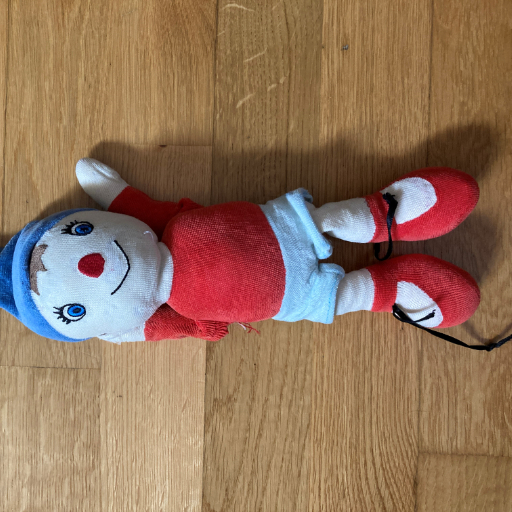

In [241]:
random_idx = random.randint(0, len(images_list)-1)
print("Random image file:", images_list[random_idx])
random_image = Image.open(images_list[random_idx])
random_image

Number of images = 12


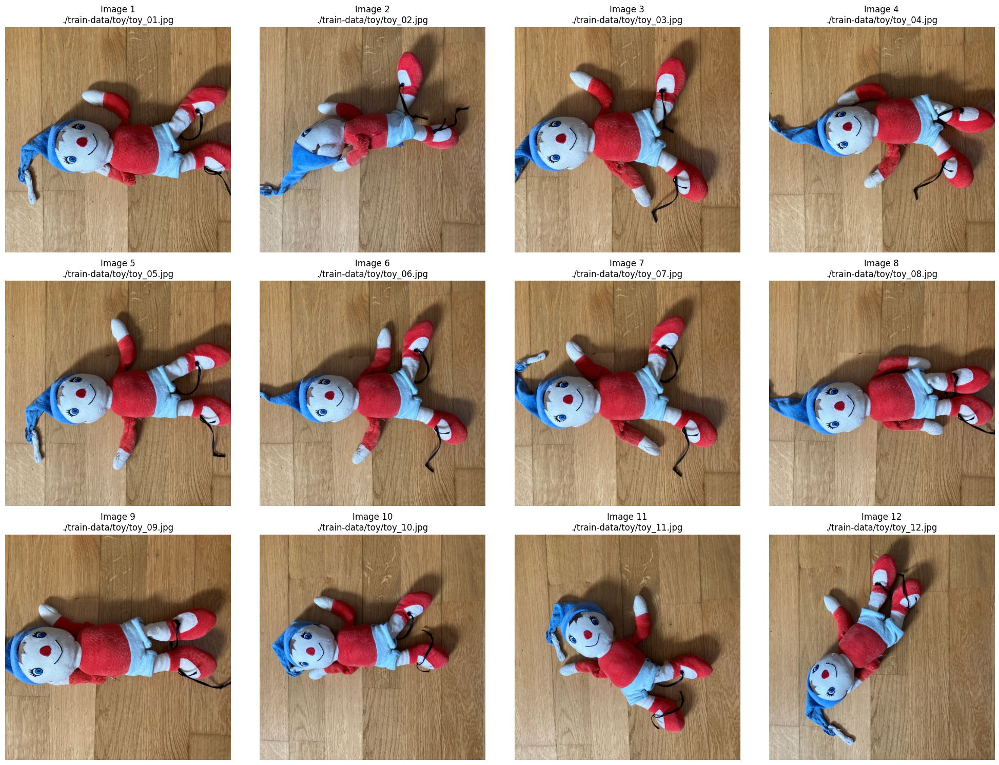

In [242]:
view_images(images_list, cols=4)

### Let's removing the background for all our images in order to keep only the main object

In [20]:
new_dir = "./train-data/toy2/"

os.makedirs(new_dir, exist_ok=True)

In [21]:
for file in images_list:
    print("Removing background from", file)
    remove_background(file, new_dir)

Removing background from ./train-data/toy/toy_01.jpg
Removing background from ./train-data/toy/toy_02.jpg
Removing background from ./train-data/toy/toy_03.jpg
Removing background from ./train-data/toy/toy_04.jpg
Removing background from ./train-data/toy/toy_05.jpg
Removing background from ./train-data/toy/toy_06.jpg
Removing background from ./train-data/toy/toy_07.jpg
Removing background from ./train-data/toy/toy_08.jpg
Removing background from ./train-data/toy/toy_09.jpg
Removing background from ./train-data/toy/toy_10.jpg
Removing background from ./train-data/toy/toy_11.jpg
Removing background from ./train-data/toy/toy_12.jpg


Number of images = 12


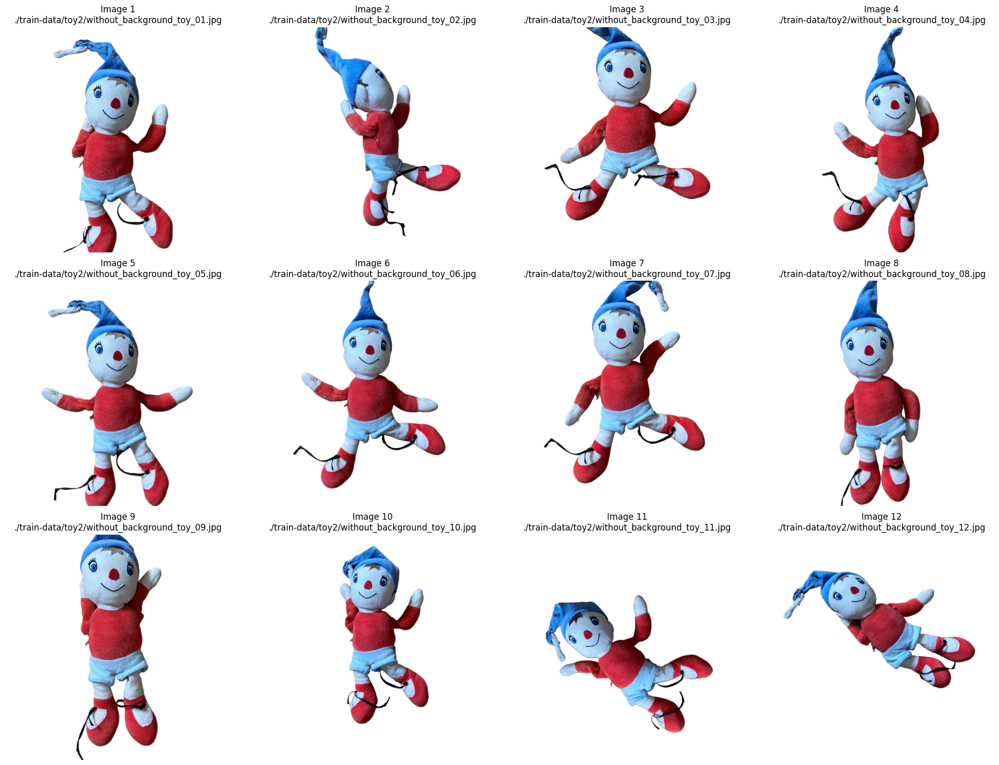

In [22]:
images_list = [
    os.path.join(new_dir, image)
    for image in os.listdir(new_dir)
    if image.endswith(".png") or image.endswith(".jpeg") or image.endswith(".jpg")
]

view_images(images_list, cols=4)

In [23]:
local_train_data = new_dir

In [24]:
my_data = Data(
    path=local_train_data,
    type=AssetTypes.URI_FOLDER,
    description="Training toys images for Dreambooth finetuning",
    name=azureml_dataset_name,
)

ml_client.data.create_or_update(my_data)

Uploading toy2 (5.9 MBs): 100%|██████████| 5898631/5898631 [00:00<00:00, 24582194.77it/s]




Data({'skip_validation': False, 'mltable_schema_url': None, 'referenced_uris': None, 'type': 'uri_folder', 'is_anonymous': False, 'auto_increment_version': False, 'name': 'toyimages', 'description': 'Training toys images for Dreambooth finetuning', 'tags': {}, 'properties': {}, 'print_as_yaml': True, 'id': '/subscriptions/b8acd8e6-3841-4717-8469-82e36dad9ae5/resourceGroups/azuremldev-rg/providers/Microsoft.MachineLearningServices/workspaces/azureml-dev/data/toyimages/versions/7', 'Resource__source_path': None, 'base_path': '/mnt/batch/tasks/shared/LS_root/mounts/clusters/gpuinstancenc6/code/Users/seretkow/Dreambooth with Azure ML', 'creation_context': <azure.ai.ml.entities._system_data.SystemData object at 0x7f6310a2b9d0>, 'serialize': <msrest.serialization.Serializer object at 0x7f6310a2a9e0>, 'version': '7', 'latest_version': None, 'path': 'azureml://subscriptions/b8acd8e6-3841-4717-8469-82e36dad9ae5/resourcegroups/azuremldev-rg/workspaces/azureml-dev/datastores/workspaceblobstore/pa

## 5. Configure and Submit Fine-Tuning Job

We have validated the solution through multiple fine-tuning runs, employing the `runwayml/stable-diffusion-v1-5` and `SG161222/Realistic_Vision_V2.0` models (refer to the `--pretrained_modelname_or_path parameter` in the cell below). The quality of the resulting model can be significantly influenced by various hyperparameters, including training steps, prompts, learning rate, and so on.

For guidance on configuring Dreambooth experiments to achieve optimal results, we recommend reviewing this [blogpost](https://huggingface.co/blog/dreambooth).

Note : 
- **instance** = custom images for dreambooth training.
- **class images** = regulization images to prevent overfitting

> Check the value for instance_prompt, class_prompt and validation_prompt in the command section

In [25]:
latest_version = [
    dataset.latest_version
    for dataset in ml_client.data.list()
    if dataset.name == azureml_dataset_name
][0]

dataset_asset = ml_client.data.get(name=azureml_dataset_name, version=latest_version)
print(f"Latest version of {azureml_dataset_name}: {latest_version}")

inputs = {
    "input_data": Input(
        type=AssetTypes.URI_FOLDER,
        path=f"azureml:{azureml_dataset_name}:{latest_version}",
    ),
}

outputs = {"output_dir": Output(type=AssetTypes.URI_FOLDER)}

# models
# runwayml/stable-diffusion-v1-5
# SG161222/Realistic_Vision_V2.0

job = command(
    inputs=inputs,
    outputs=outputs,
    code="./src",
    command="""python prepare.py && accelerate launch --num_processes 1 train_dreambooth.py \
                --pretrained_model_name_or_path="SG161222/Realistic_Vision_V2.0" \
                --instance_data_dir=${{inputs.input_data}} \
                --class_data_dir="outputs/class-images" \
                --output_dir="outputs/models" \
                --train_text_encoder \
                --with_prior_preservation --prior_loss_weight=1.0 \
                --enable_xformers_memory_efficient_attention \
                --instance_prompt="photo of a zwx stuffed toy" \
                --class_prompt="photo of a stuffed toy" \
                --resolution=512 \
                --checkpointing_steps=500 \
                --train_batch_size=2 \
                --validation_prompt="photo of a zwx stuffed toy" \
                --num_validation_images=4 \
                --validation_steps=100 \
                --gradient_accumulation_steps=1 \
                --scale_lr \
                --gradient_checkpointing \
                --learning_rate=1e-7 --lr_scheduler="constant" \
                --lr_warmup_steps=0 \
                --num_class_images=600 \
                --max_train_steps=2000 && python inference.py --model_path outputs/models""",
    environment_variables={"PYTORCH_CUDA_ALLOC_CONF": "max_split_size_mb:100"},
    environment="dreambooth-env@latest",
    compute=train_target,
    experiment_name=experiment_name,
    display_name="Dreambooth noddy toy product example, RV 2.0, 2k steps",
)

returned_job = ml_client.jobs.create_or_update(job)
returned_job

Latest version of toyimages: 7


Experiment,Name,Type,Status,Details Page
dreambooth-finetuning,witty_cart_r4z03j4pwr,command,Starting,Link to Azure Machine Learning studio


> Wait until the completion of the Azure ML job.

## 6. Downloading the model

In [26]:
job_name = returned_job.name  # use above job (or: job_name = "ashy_ant_c32jlq6g7z	")

In [27]:
# Obtain the tracking URL from MLClient
MLFLOW_TRACKING_URI = ml_client.workspaces.get(
    name=ml_client.workspace_name
).mlflow_tracking_uri

# Set the MLFLOW TRACKING URI
mlflow.set_tracking_uri(MLFLOW_TRACKING_URI)

# Initialize MLFlow client
mlflow_client = MlflowClient()
mlflow_run = mlflow_client.get_run(job_name)

mlflow.artifacts.download_artifacts(
    run_id=mlflow_run.info.run_id,
    artifact_path="outputs/models/",  # Azure ML job output
    dst_path="./train-artifacts",
)

'/mnt/batch/tasks/shared/LS_root/mounts/clusters/gpuinstancenc6/code/Users/seretkow/Dreambooth with Azure ML/train-artifacts/outputs/models/'

In [28]:
json_path = "./train-artifacts/outputs/models/model_index.json"

if os.path.isdir(json_path):
    shutil.rmtree(json_path)
    
    mlflow.artifacts.download_artifacts(
        run_id=mlflow_run.info.run_id,
        artifact_path="outputs/models/model_index.json",  # Azure ML job output
        dst_path="./train-artifacts",
    )

## 7. Pipeline definition

In [29]:
print(get_gpu_info())

Tue Jun 13 12:20:34 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.182.03   Driver Version: 470.182.03   CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000001:00:00.0 Off |                  Off |
| N/A   29C    P0    24W / 250W |      4MiB / 16160MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [30]:
device = "cuda"

scheduler = DDIMScheduler(
    beta_start=0.00085,
    beta_end=0.012,
    beta_schedule="scaled_linear",
    clip_sample=False,
    set_alpha_to_one=True,
)

pipe = StableDiffusionPipeline.from_pretrained(
    pretrained_model_name_or_path="./train-artifacts/outputs/models/",
    scheduler=scheduler,
    safety_checker=None,
    torch_dtype=torch.float16,
    low_cpu_mem_usage=False,
).to(device)

# TODO: enable reuse specific checkpoint:
# https://huggingface.co/docs/diffusers/training/dreambooth

The config attributes {'encoder_hid_dim_type': None} were passed to UNet2DConditionModel, but are not expected and will be ignored. Please verify your config.json configuration file.
Some weights of the model checkpoint at ./train-artifacts/outputs/models/vae were not used when initializing AutoencoderKL: ['decoder.mid_block.attentions.0.to_q.bias', 'encoder.mid_block.attentions.0.to_out.0.bias', 'decoder.mid_block.attentions.0.to_k.weight', 'encoder.mid_block.attentions.0.to_q.bias', 'encoder.mid_block.attentions.0.to_k.weight', 'encoder.mid_block.attentions.0.to_q.weight', 'decoder.mid_block.attentions.0.to_out.0.bias', 'decoder.mid_block.attentions.0.to_out.0.weight', 'decoder.mid_block.attentions.0.to_q.weight', 'encoder.mid_block.attentions.0.to_out.0.weight', 'encoder.mid_block.attentions.0.to_v.weight', 'encoder.mid_block.attentions.0.to_v.bias', 'decoder.mid_block.attentions.0.to_v.weight', 'encoder.mid_block.attentions.0.to_k.bias', 'decoder.mid_block.attentions.0.to_k.bias', 

## 8. Generating the artificial images

### Funcion to generate an artificial image for 1 prompt

In [31]:
def get_artificial_images(prompt, num_images=1):
    """
    Generate artificial images from a prompt
    """
    suffix = ", (high detailed skin:1.2), 8k uhd, dslr, advertising photography, high quality,\
    film grain, real-world, unedited, photorealistic, Fujifilm XT3, natural"

    negative_prompt = "(semi-realistic, cgi, 3d, render, sketch, cartoon, drawing, anime:1.4),\
    text, close up, cropped, out of frame, worst quality, low quality, jpeg artifacts, ugly,\
    duplicate, morbid, mutilated, extra fingers, mutated hands, poorly drawn hands,\
    poorly drawn face, mutation, deformed, blurry, dehydrated, bad anatomy, bad proportions,\
    extra limbs, cloned face, disfigured, gross proportions, malformed limbs, missing arms,\
    missing legs, extra arms, extra legs, fused fingers, too many fingers, long neck"

    print("Prompt:", prompt)
    
    images = pipe(
        prompt=prompt + suffix,
        negative_prompt=negative_prompt,
        height=512,
        width=768,
        guidance_scale=7.5,
        num_inference_steps=50,
        num_images_per_prompt=num_images,
    ).images
   
    return images

### Multiple prompts to generate our artificial images

In [244]:
prompts = [
    "Take a close-up product studio shot of a zwx stuffed toy with Paris in the background.",
    "Take a close-up product studio shot of a zwx stuffed toy with a tropical island in the background.",
    "Capture an ethereal product studio photo of a zwx stuffed toy illuminated by soft, diffused light in a busy street.",
    "Generate an image of a zwx stuffed toy close to a cat.",
    "Generate an image of a zwx stuffed toy close to a elephant.",
    "Generate an image of two zwx stuffed toy dancing together.",
    "Generate an image of a zwx stuffed toy with a colorful bowtie.",
    "Generate an image of a zwx stuffed toy with a vibrant patterned fabric.",
    "Create an image of a zwx stuffed toy wearing a winter scarf and a top hat.",
    "Generate an image of a zwx stuffed toy with a ball of yarn.",
    "Create an image of a szwx stuffed toy with a crown on its head.",
    "Generate an image of a zwx stuffed toy swinging from a branch.",
    "Product studio photography of zwx stuffed toy tin in a human hand",
    "Product studio photography tin of zwx stuffed toy in a shelf",
    "Product studio photography closeup tin of zwx stuffed toy with lake in background",
    "Product studio photography tin of zwx stuffed toy in a street",
    "A magical zwx stuffed toy tin, futuristic, stunning product studio photography, low-key lighting, bokeh, smoke effects",
    "Product studio photography tin of zwx stuffed toy on icy lake with reflections. bokeh, blue sky.",  
    "Produce a futuristic photograph of a zwx stuffed toy with Picasso-inspired colors on a dusty table.",
    "Take a close-up product studio shot of a zwx stuffed toy with a serene lake in the background.",
    "Craft a product studio image of a zwx stuffed toy in sandy surroundings with a captivating desert sunset in the backdrop.",
    "Create a mesmerizing and magical product studio photo of a zwx stuffed toy using low-key lighting, bokeh, and smoke effects.",
    "Generate an artistic image of a zwx stuffed toy on an icy lake, capturing reflections and featuring beautiful bokeh against a blue sky.",
    "Create stunning artificial imagery of a zwx stuffed toy."
    "Capture an artistic composition of a zwx stuffed toy surrounded by vibrant flowers in a product studio photography setting.",
    "Create an abstract product studio image of a zwx stuffed toy with swirling patterns and neon colors.",
    "Generate a surreal photograph of a zwx stuffed toy floating in mid-air with a celestial background.",
    "Produce a minimalist product studio photo of a zwx stuffed toy against a plain white backdrop, highlighting its sleek design.",
    "Craft an underwater-themed image of a zwx stuffed toy submerged in a crystal-clear pool with rays of sunlight shining through.",
    "Generate an avant-garde product studio photograph of a zwx stuffed toy featuring unconventional angles and lighting.",
    "Create a high-tech image of a zwx stuffed toy surrounded by holographic projections in a futuristic environment.",
    "Capture an ethereal product studio photo of a zwx stuffed toy illuminated by soft, diffused light in a misty forest.",
    "Produce a dramatic black and white image of a zwx stuffed toy against a stormy sky, evoking a sense of power and sophistication.",
    "Generate a whimsical photograph of a zwx stuffed toy transformed into a fantasy creature, complete with mythical elements and magical lighting.",
    "Create a dynamic product studio image of a zwx stuffed toy worn by a futuristic superhero, showcasing their incredible powers.",
]

In [245]:
print("\033[1;31;34m")

print("Total number of prompts =", len(prompts), "\n")

for idx, item in enumerate(prompts, start=1):
    print(f"Prompt {idx:03}: {item}")


Total number of prompts = 34 

Prompt 001: Take a close-up product studio shot of a zwx stuffed toy with Paris in the background.
Prompt 002: Take a close-up product studio shot of a zwx stuffed toy with a tropical island in the background.
Prompt 003: Capture an ethereal product studio photo of a zwx stuffed toy illuminated by soft, diffused light in a busy street.
Prompt 004: Generate an image of a zwx stuffed toy close to a cat.
Prompt 005: Generate an image of a zwx stuffed toy close to a elephant.
Prompt 006: Generate an image of two zwx stuffed toy dancing together.
Prompt 007: Generate an image of a zwx stuffed toy with a colorful bowtie.
Prompt 008: Generate an image of a zwx stuffed toy with a vibrant patterned fabric.
Prompt 009: Create an image of a zwx stuffed toy wearing a winter scarf and a top hat.
Prompt 010: Generate an image of a zwx stuffed toy with a ball of yarn.
Prompt 011: Create an image of a szwx stuffed toy with a crown on its head.
Prompt 012: Generate an im

### Running the artificial images for all the prompts

In [246]:
def get_all_artificial_images():
    """
    Generating the images using multiple prompts
    """
    # Deleting the directory of the results
    if os.path.exists(generated_images):
        shutil.rmtree(generated_images)
    os.makedirs(generated_images, exist_ok=True)

    idx = 1

    for prompt in prompts:
        print(f"Generating image {idx:03}")
        image = get_artificial_images(prompt)[0]
        dt = datetime.now().strftime("%Y%m%d_%H%M%S_%f")
        outputname = f"image_{dt}.png"
        outputfile = os.path.join(generated_images, outputname)
        image.save(outputfile)
        print(f"Image saved: {outputfile}\n")
        idx += 1

    # Get the list of the generated images
    gen_images_list = [
        os.path.join(generated_images, image)
        for image in os.listdir(generated_images)
        if image.endswith(".png")
    ]

    print("\nDone.")
    print("Number of generated images =", len(gen_images_list))

    return gen_images_list

In [247]:
list_artificial_images = get_all_artificial_images()

Generating image 001
Prompt: Take a close-up product studio shot of a zwx stuffed toy with Paris in the background.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133251_219255.png

Generating image 002
Prompt: Take a close-up product studio shot of a zwx stuffed toy with a tropical island in the background.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133256_032764.png

Generating image 003
Prompt: Capture an ethereal product studio photo of a zwx stuffed toy illuminated by soft, diffused light in a busy street.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133300_778729.png

Generating image 004
Prompt: Generate an image of a zwx stuffed toy close to a cat.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133305_542797.png

Generating image 005
Prompt: Generate an image of a zwx stuffed toy close to a elephant.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133310_279644.png

Generating image 006
Prompt: Generate an image of two zwx stuffed toy dancing together.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133315_039661.png

Generating image 007
Prompt: Generate an image of a zwx stuffed toy with a colorful bowtie.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133319_810949.png

Generating image 008
Prompt: Generate an image of a zwx stuffed toy with a vibrant patterned fabric.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133324_596093.png

Generating image 009
Prompt: Create an image of a zwx stuffed toy wearing a winter scarf and a top hat.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133329_363040.png

Generating image 010
Prompt: Generate an image of a zwx stuffed toy with a ball of yarn.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133334_129136.png

Generating image 011
Prompt: Create an image of a szwx stuffed toy with a crown on its head.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133338_912816.png

Generating image 012
Prompt: Generate an image of a zwx stuffed toy swinging from a branch.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133343_623668.png

Generating image 013
Prompt: Product studio photography of zwx stuffed toy tin in a human hand


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133348_340478.png

Generating image 014
Prompt: Product studio photography tin of zwx stuffed toy in a shelf


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133353_120820.png

Generating image 015
Prompt: Product studio photography closeup tin of zwx stuffed toy with lake in background


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133357_883895.png

Generating image 016
Prompt: Product studio photography tin of zwx stuffed toy in a street


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133402_639954.png

Generating image 017
Prompt: A magical zwx stuffed toy tin, futuristic, stunning product studio photography, low-key lighting, bokeh, smoke effects


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133407_388402.png

Generating image 018
Prompt: Product studio photography tin of zwx stuffed toy on icy lake with reflections. bokeh, blue sky.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133412_134981.png

Generating image 019
Prompt: Produce a futuristic photograph of a zwx stuffed toy with Picasso-inspired colors on a dusty table.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133416_930705.png

Generating image 020
Prompt: Take a close-up product studio shot of a zwx stuffed toy with a serene lake in the background.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133421_696074.png

Generating image 021
Prompt: Craft a product studio image of a zwx stuffed toy in sandy surroundings with a captivating desert sunset in the backdrop.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133426_482090.png

Generating image 022
Prompt: Create a mesmerizing and magical product studio photo of a zwx stuffed toy using low-key lighting, bokeh, and smoke effects.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133431_244869.png

Generating image 023
Prompt: Generate an artistic image of a zwx stuffed toy on an icy lake, capturing reflections and featuring beautiful bokeh against a blue sky.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133436_013995.png

Generating image 024
Prompt: Create stunning artificial imagery of a zwx stuffed toy.Capture an artistic composition of a zwx stuffed toy surrounded by vibrant flowers in a product studio photography setting.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133440_795128.png

Generating image 025
Prompt: Create an abstract product studio image of a zwx stuffed toy with swirling patterns and neon colors.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133445_530218.png

Generating image 026
Prompt: Generate a surreal photograph of a zwx stuffed toy floating in mid-air with a celestial background.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133450_300201.png

Generating image 027
Prompt: Produce a minimalist product studio photo of a zwx stuffed toy against a plain white backdrop, highlighting its sleek design.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133455_014175.png

Generating image 028
Prompt: Craft an underwater-themed image of a zwx stuffed toy submerged in a crystal-clear pool with rays of sunlight shining through.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133459_804417.png

Generating image 029
Prompt: Generate an avant-garde product studio photograph of a zwx stuffed toy featuring unconventional angles and lighting.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133504_616773.png

Generating image 030
Prompt: Create a high-tech image of a zwx stuffed toy surrounded by holographic projections in a futuristic environment.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133509_382590.png

Generating image 031
Prompt: Capture an ethereal product studio photo of a zwx stuffed toy illuminated by soft, diffused light in a misty forest.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133514_140992.png

Generating image 032
Prompt: Produce a dramatic black and white image of a zwx stuffed toy against a stormy sky, evoking a sense of power and sophistication.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133518_912461.png

Generating image 033
Prompt: Generate a whimsical photograph of a zwx stuffed toy transformed into a fantasy creature, complete with mythical elements and magical lighting.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133523_669234.png

Generating image 034
Prompt: Create a dynamic product studio image of a zwx stuffed toy worn by a futuristic superhero, showcasing their incredible powers.


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved: ./results/toy/image_20230613_133528_393610.png


Done.
Number of generated images = 34


### List of generated images

In [248]:
!ls $generated_images -lh

total 19M
-rwxrwxrwx 1 root root 493K Jun 13 13:32 image_20230613_133251_219255.png
-rwxrwxrwx 1 root root 646K Jun 13 13:32 image_20230613_133256_032764.png
-rwxrwxrwx 1 root root 474K Jun 13 13:33 image_20230613_133300_778729.png
-rwxrwxrwx 1 root root 510K Jun 13 13:33 image_20230613_133305_542797.png
-rwxrwxrwx 1 root root 592K Jun 13 13:33 image_20230613_133310_279644.png
-rwxrwxrwx 1 root root 560K Jun 13 13:33 image_20230613_133315_039661.png
-rwxrwxrwx 1 root root 493K Jun 13 13:33 image_20230613_133319_810949.png
-rwxrwxrwx 1 root root 618K Jun 13 13:33 image_20230613_133324_596093.png
-rwxrwxrwx 1 root root 617K Jun 13 13:33 image_20230613_133329_363040.png
-rwxrwxrwx 1 root root 588K Jun 13 13:33 image_20230613_133334_129136.png
-rwxrwxrwx 1 root root 595K Jun 13 13:33 image_20230613_133338_912816.png
-rwxrwxrwx 1 root root 575K Jun 13 13:33 image_20230613_133343_623668.png
-rwxrwxrwx 1 root root 588K Jun 13 13:33 image_20230613_133348_340478.png
-rwxrwxrwx 1 root root 507K 

### Some artificial images

In [249]:
def view_gen_image(idx):
    """
    View generated image
    """
    try:
        img = Image.open(list_artificial_images[idx])
        print("Prompt:", prompts[idx])
        display(img)
    except:
        print("Error. Check if you chose a valid index number.")

Prompt: Take a close-up product studio shot of a zwx stuffed toy with Paris in the background.


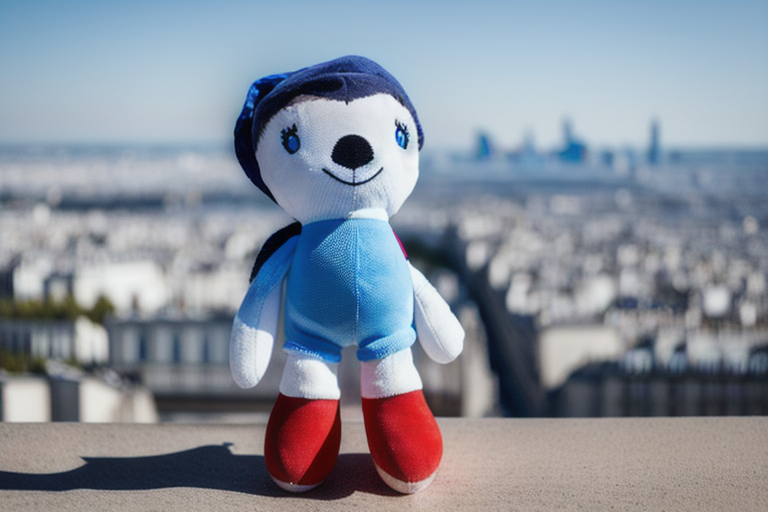

In [250]:
view_gen_image(0)

Prompt: Take a close-up product studio shot of a zwx stuffed toy with a tropical island in the background.


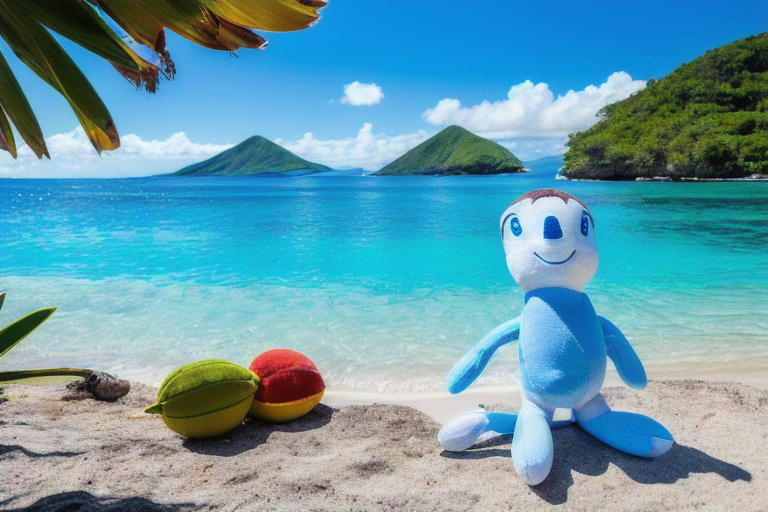

In [261]:
view_gen_image(1)

Prompt: Generate an image of a zwx stuffed toy close to a elephant.


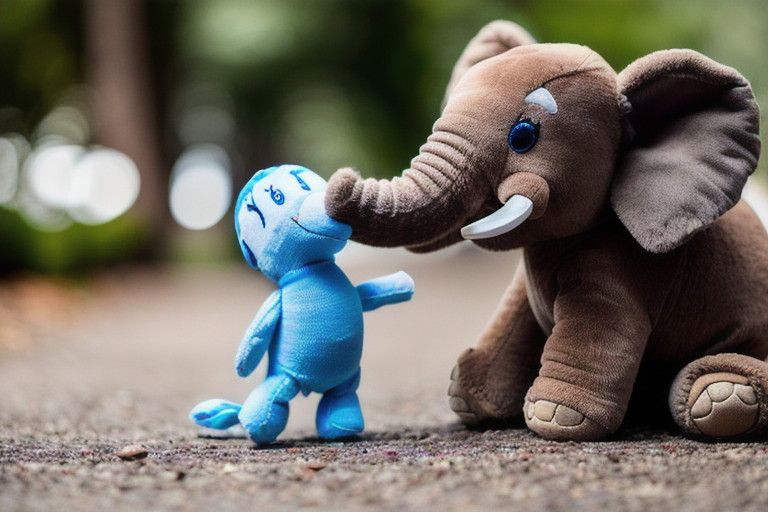

In [251]:
view_gen_image(4)

Prompt: A magical zwx stuffed toy tin, futuristic, stunning product studio photography, low-key lighting, bokeh, smoke effects


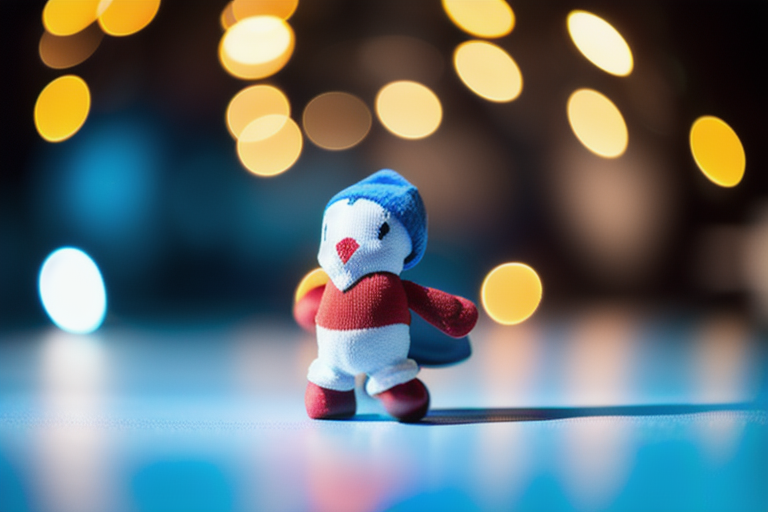

In [253]:
view_gen_image(16)

Prompt: Generate a surreal photograph of a zwx stuffed toy floating in mid-air with a celestial background.


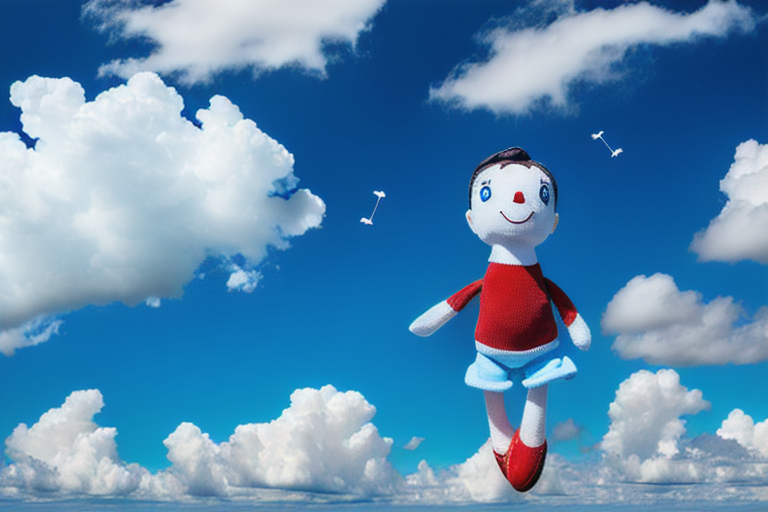

In [255]:
view_gen_image(25)

Prompt: Craft an underwater-themed image of a zwx stuffed toy submerged in a crystal-clear pool with rays of sunlight shining through.


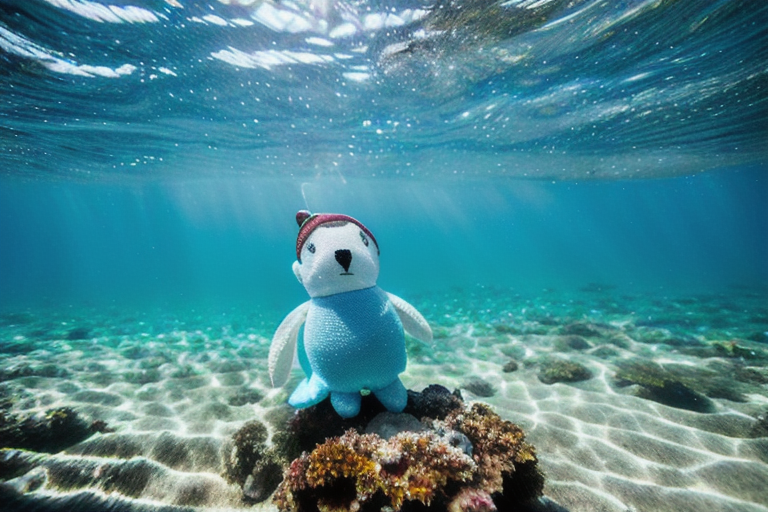

In [262]:
view_gen_image(27)

Prompt: Generate a whimsical photograph of a zwx stuffed toy transformed into a fantasy creature, complete with mythical elements and magical lighting.


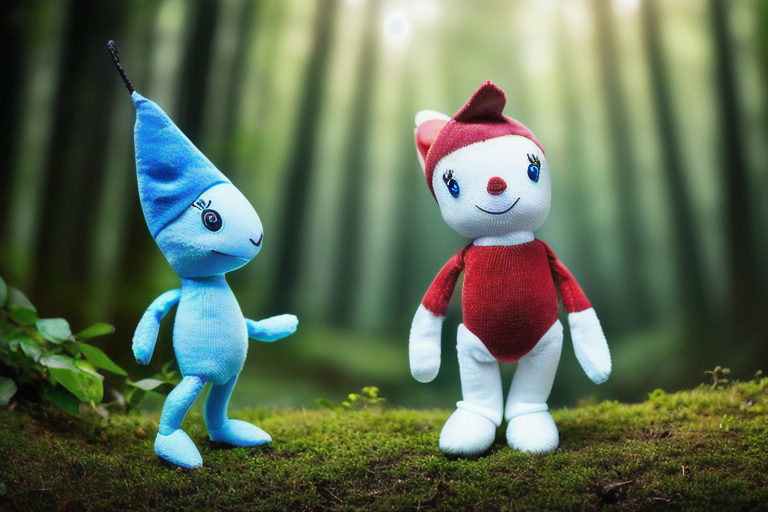

In [263]:
view_gen_image(32)

### Viewing all the generated images

In [259]:
%%javascript

IPython.OutputArea.auto_scroll_threshold = 9999

<IPython.core.display.Javascript object>

Number of images = 34


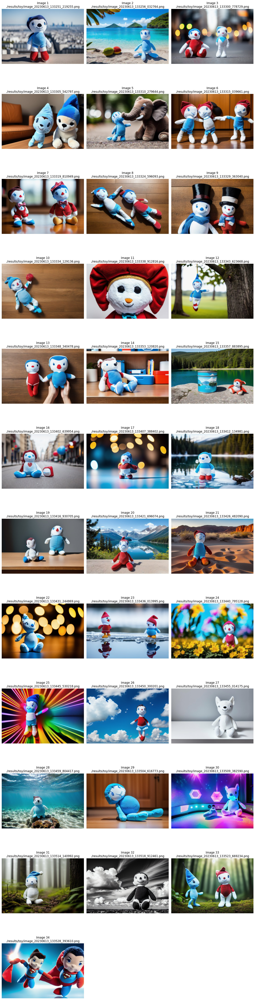

In [260]:
view_images(list_artificial_images, cols=3)